In [1]:
from mars_code.mars_currents.grid import spherical_grid
import spiceypy as spice
from mars_code.mars_currents import binning
from mars_code.mars_currents.maps import mollweide_maps

spice.furnsh("pck00010.tpc")
mars_radius = spice.bodvcd(499, "RADII", 3)[1][0]

In [2]:
file_name = "mag_mse_2015-10-03_2016-10-14_n20_all.csv"
# file_name = ("thesis/codes/mag_mse_2014-10-11_2020-08-14_n15_all.csv")

In [10]:
%%time
grid = binning.init_grid(
    data_file_name=file_name,
    load_from_file=True,
    file_path="grid_dr0.04_dth10_dphi18__mag_mse_2015-10-03_2020-08-14_ms_n20_all.pickle",
    dr=0.3,
    dth=30,
    dphi=18,
    r_lim=[1.025, 2.9],
    th_lim=[0, 180],
    phi_lim=[-180, 180],
)

CPU times: user 472 ms, sys: 60.6 ms, total: 533 ms
Wall time: 534 ms


In [4]:
%%time
# grid = binning.binning(grid, data_file_name=file_name)

CPU times: user 18.4 s, sys: 3.54 s, total: 21.9 s
Wall time: 18.1 s


In [5]:
%%time
# grid.currents_uncertainties(mars_radius)

CPU times: user 173 ms, sys: 5.52 ms, total: 179 ms
Wall time: 175 ms


In [7]:
# grid.save_grid()

/Users/apostolosk/Desktop/maven_proj/mars_currents/mars_code/mars_currents/maps/mollweide_maps.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(
/Users/apostolosk/Desktop/maven_proj/mars_currents/mars_code/mars_currents/maps/mollweide_maps.py:35: RuntimeWarning: All-NaN slice encountered
  comp_max = max(np.nanmax(u[0]), np.nanmax(u[1]), np.nanmax(u[2]))
/Users/apostolosk/Desktop/maven_proj/mars_currents/mars_code/mars_currents/maps/mollweide_maps.py:36: RuntimeWarning: All-NaN slice encountered
  comp_min = min(np.nanmin(u[0]), np.nanmin(u[1]), np.nanmin(u[2]))
/opt/anaconda3/envs/maven_projects/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered i

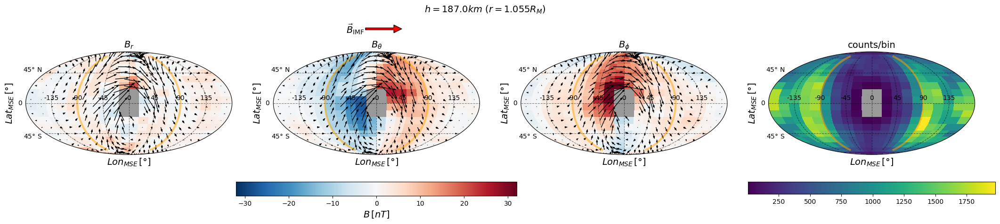

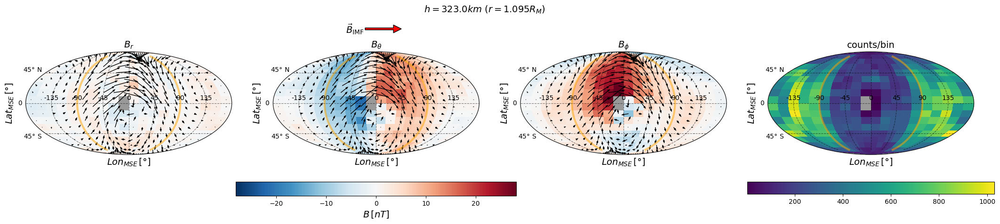

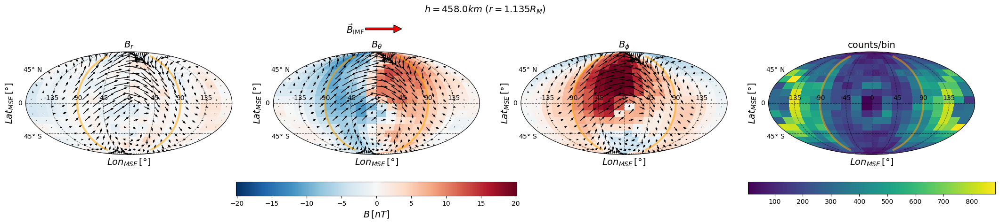

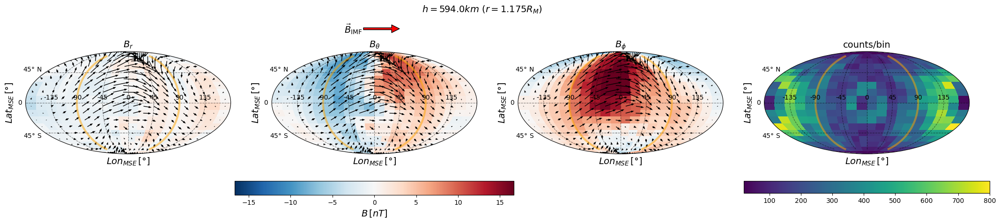

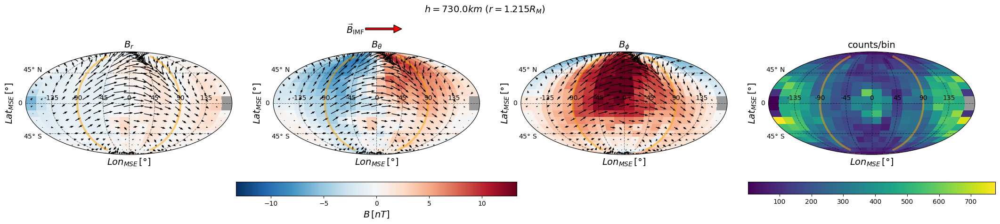

...

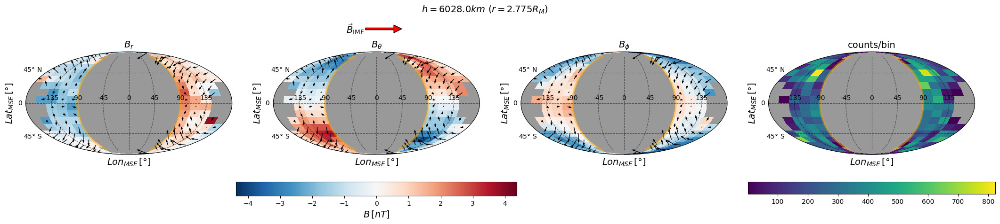

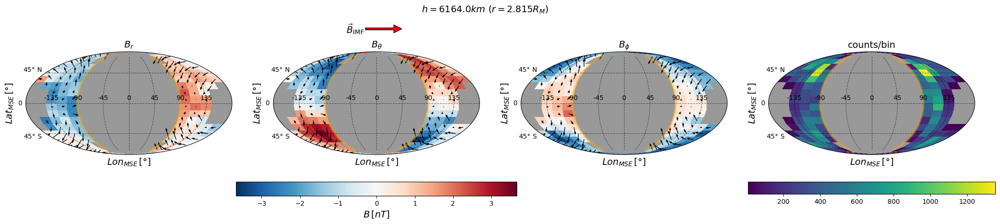

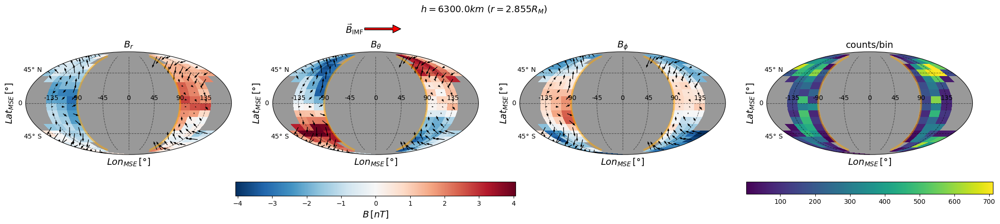

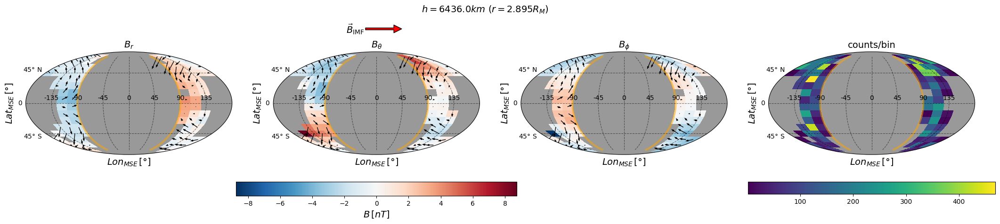

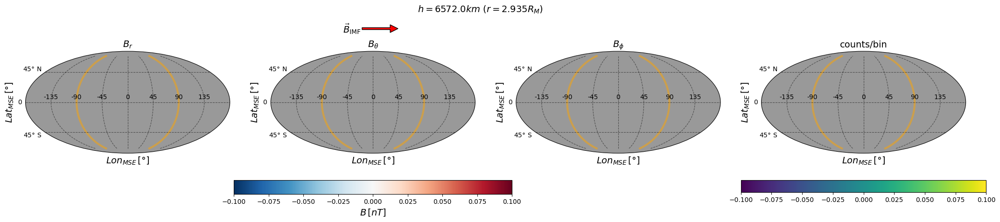

In [11]:
mollweide_maps(
    grid,
    maps=["Br_sm", "Bth_sm", "Bphi_sm", "measurement_counts"],
    maps_names=[r"$B_{r}$", r"$B_{\theta}$", r"$B_{\phi}$", "counts/bin"],
    cb_names=[r"$B \, [nT]$", ""],
    fts=14,
    hw=3,
    hl=4,
    hal=5,
    plots_path=f"../plots",
    map_type_name="magnetic_field",
    save=False,
    cb_lim=None,
);

/Users/apostolosk/Desktop/maven_proj/mars_currents/mars_code/mars_currents/maps/mollweide_maps.py:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(
/Users/apostolosk/Desktop/maven_proj/mars_currents/mars_code/mars_currents/maps/mollweide_maps.py:35: RuntimeWarning: All-NaN slice encountered
  comp_max = max(np.nanmax(u[0]), np.nanmax(u[1]), np.nanmax(u[2]))
/Users/apostolosk/Desktop/maven_proj/mars_currents/mars_code/mars_currents/maps/mollweide_maps.py:36: RuntimeWarning: All-NaN slice encountered
  comp_min = min(np.nanmin(u[0]), np.nanmin(u[1]), np.nanmin(u[2]))
/opt/anaconda3/envs/maven_projects/lib/python3.10/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered i

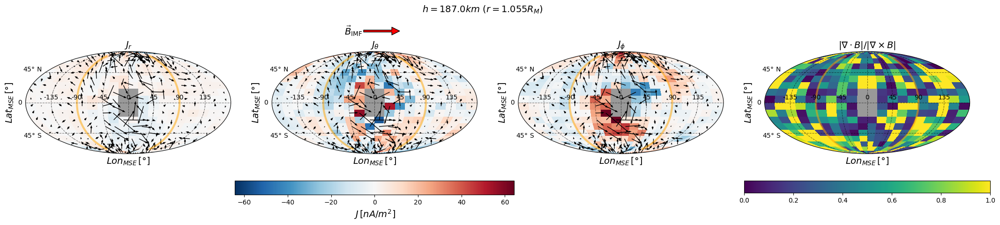

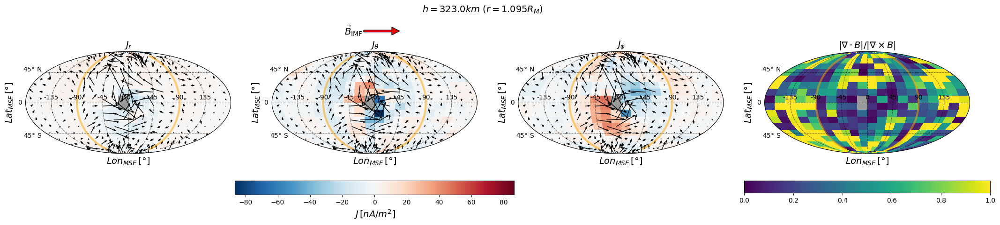

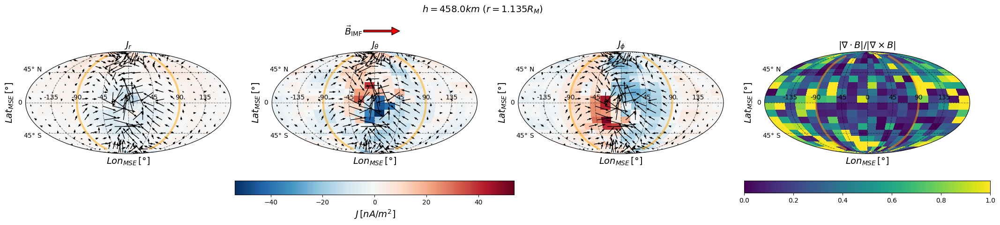

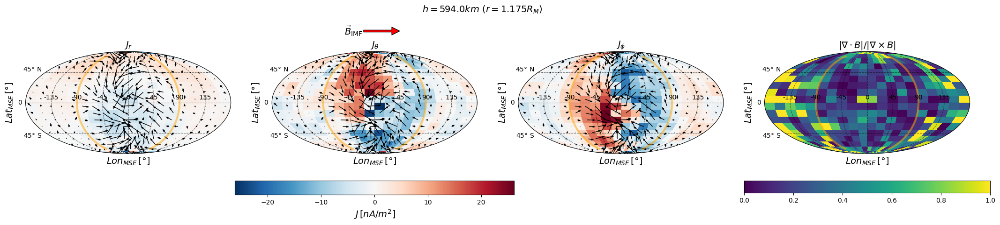

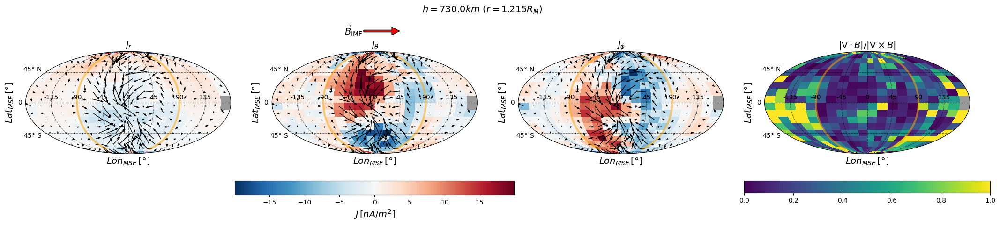

...

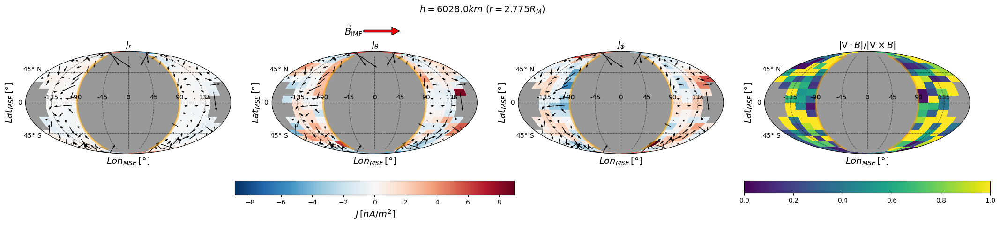

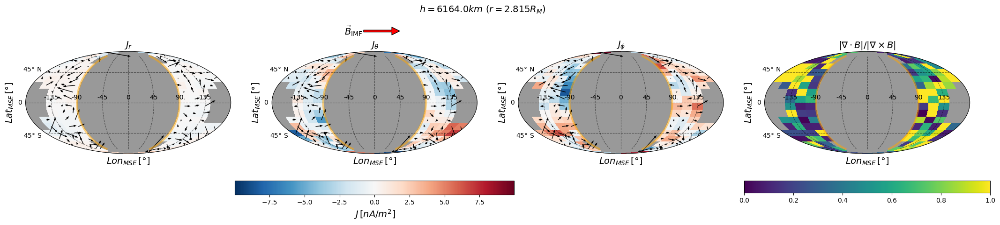

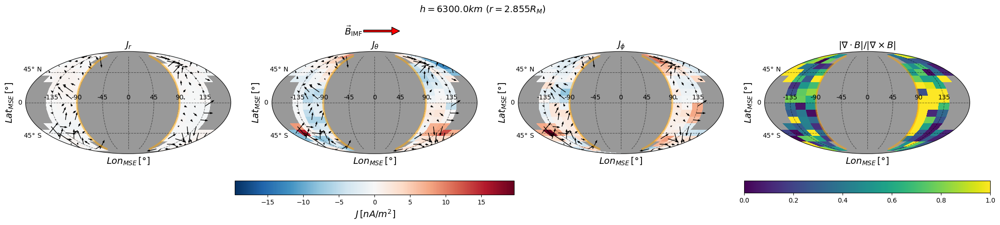

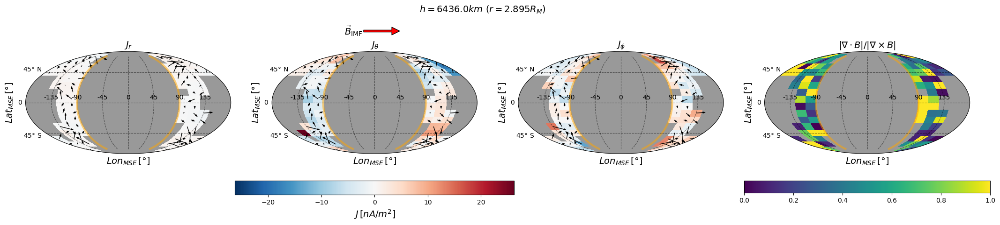

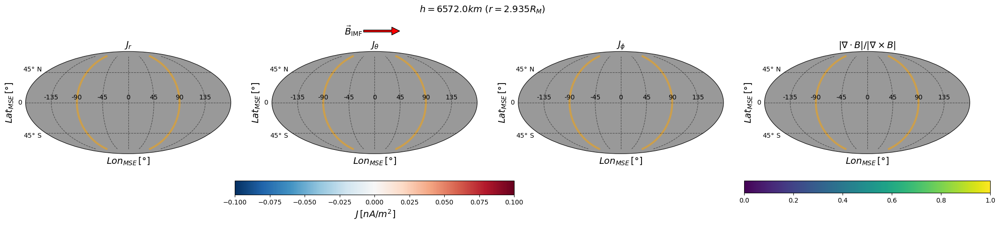

In [12]:
mollweide_maps(
    grid,
    maps=["Jr", "Jth", "Jphi", "divB_curlB"],
    maps_names=[
        r"$J_{r}$",
        r"$J_{\theta}$",
        r"$J_{\phi}$",
        r"$|\nabla \cdot B |/ |\nabla \times B|$",
    ],
    cb_names=[r"$J \, [nA/m^{2}]$", ""],
    fts=14,
    hw=3,
    hl=4,
    hal=5,
    plots_path=f"../plots",
    map_type_name="current_density",
    save=False,
    cb_lim=None,
);